# Preparacion del Dataset

In [1]:
import pandas as pd
import numpy as np

En este trabajo se utilizan DataFrames para procesar y ordenar las diferentes bases de datos (o datasets), por lo que estos términos se utilizan de manera indiferente en la notebook

In [2]:
df = pd.read_csv('datos/SESNSP/IDEFC_NM_ene24.csv', encoding = "ISO-8859-1") #Recuperado del sitio oficial del SESNSP
df = df.fillna(value = 0)
df.head(3)

,Año,Clave_Ent,Entidad,Bien jurídico afectado,Tipo de delito,Subtipo de delito,Modalidad,Enero,Febrero,Marzo,Abril,Mayo,Junio,Julio,Agosto,Septiembre,Octubre,Noviembre,Diciembre
0,2015,1,Aguascalientes,La vida y la Integridad corporal,Homicidio,Homicidio doloso,Con arma de fuego,3,0.0,2.0,1.0,1.0,1.0,2.0,1.0,2.0,2.0,2.0,1.0
1,2015,1,Aguascalientes,La vida y la Integridad corporal,Homicidio,Homicidio doloso,Con arma blanca,1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0
2,2015,1,Aguascalientes,La vida y la Integridad corporal,Homicidio,Homicidio doloso,Con otro elemento,0,0.0,2.0,2.0,3.0,2.0,0.0,1.0,2.0,0.0,0.0,0.0


Se observa que esta base de datos contiene información a partir del 2015 acerca del número de delitos cometidos al mes por estado, utilizando 3 tipos de clasificaciones. Sin embargo para este análisis se utilizará el total de delitos por año y la clasificación "tipo de delito". Observamos que se tienen 40 tipos de delitos

In [3]:
len(df['Tipo de delito'].unique())

40

In [4]:
df['Tipo de delito'].unique()

array(['Homicidio', 'Lesiones', 'Feminicidio', 'Aborto',
       'Otros delitos que atentan contra la vida y la integridad corporal',
       'Secuestro', 'Tráfico de menores', 'Rapto',
       'Otros delitos que atentan contra la libertad personal',
       'Abuso sexual', 'Acoso sexual', 'Hostigamiento sexual',
       'Violación simple', 'Violación equiparada', 'Incesto',
       'Otros delitos que atentan contra la libertad y la seguridad sexual',
       'Robo', 'Fraude', 'Abuso de confianza', 'Extorsión',
       'Daño a la propiedad', 'Despojo',
       'Otros delitos contra el patrimonio', 'Violencia familiar',
       'Violencia de género en todas sus modalidades distinta a la violencia familiar',
       'Incumplimiento de obligaciones de asistencia familiar',
       'Otros delitos contra la familia', 'Corrupción de menores',
       'Trata de personas', 'Otros delitos contra la sociedad',
       'Narcomenudeo', 'Amenazas', 'Allanamiento de morada',
       'Evasión de presos', 'Falsedad'

In [5]:
df.dtypes # Se observa que enero es de tipo entero

Año                         int64
Clave_Ent                   int64
Entidad                    object
Bien jurídico afectado     object
Tipo de delito             object
Subtipo de delito          object
Modalidad                  object
Enero                       int64
Febrero                   float64
Marzo                     float64
Abril                     float64
Mayo                      float64
Junio                     float64
Julio                     float64
Agosto                    float64
Septiembre                float64
Octubre                   float64
Noviembre                 float64
Diciembre                 float64
dtype: object

In [6]:
df['Enero'] = df['Enero'].astype(float) #Se cambia la columna a tipo flotante para futuros calculos

In [7]:
# Se agrupa de acuerdo al tipo de delito, conservando el año, la entidad y su clave
df = df.groupby(['Año', 'Clave_Ent', 'Entidad','Tipo de delito']).sum().reset_index()
# Se descartan los otros tipos de clasificaciones
df.drop(columns = ['Bien jurídico afectado','Subtipo de delito','Modalidad'], inplace = True)
# Se descarta la informacion del año actual puesto que se encuetra incompleta
df = df[df['Año'] < 2024]
# Se crea una nueva columna para total de delitos anuales
df['DelitosTotales'] = df.iloc[:, -12:].sum(axis=1)
# Se descartan las columnas de los meses
df = df.drop(df.columns[4:16], axis=1)

In [8]:
df

,Año,Clave_Ent,Entidad,Tipo de delito,DelitosTotales
0,2015,1,Aguascalientes,Aborto,5.0
1,2015,1,Aguascalientes,Abuso de confianza,419.0
2,2015,1,Aguascalientes,Abuso sexual,18.0
3,2015,1,Aguascalientes,Acoso sexual,0.0
4,2015,1,Aguascalientes,Allanamiento de morada,169.0
...,...,...,...,...,...
11515,2023,32,Zacatecas,Tráfico de menores,0.0
11516,2023,32,Zacatecas,Violación equiparada,129.0
11517,2023,32,Zacatecas,Violación simple,161.0
11518,2023,32,Zacatecas,Violencia de género en todas sus modalidades d...,0.0


Este será el dataframe principal sobre el cual se añadirá información adicional y se derivarán otros subsets

## Anexar información de otras bases de datos

Se agragarán nuevas columnas con información sobre empleo, ocupación, salud y demografía con información obtenida de bases de datos del INEGI y el SNIEG
La columna "Clave_Ent" se obtiene ordenando el nombre de los estados en orden alfabético y asignándoles un número del 1 al 32. Esta columna será util para unir el dataset original con la nueva información

Se mostrará el procedimiento detallado para anexar la información correspondiente al primer atributo, y se realizarán comentarios en las demás cuando se considere pertinente

### Poblacion

La API de Indicadores del INEGI permite consultar los datos y metadatos de los indicadores disponibles a nivel nacional, por entidad federativa y municipio. Es posible utilizar la API para crear aplicaciones que muestren la información directamente de las bases de datos del INEGI en el preciso momento en que se actualiza.
[[1]](https://www.inegi.org.mx/servicios/api_indicadores.html)

In [9]:
import requests
import json

In [10]:
#Llamada a la API
url='https://www.inegi.org.mx/app/api/indicadores/desarrolladores/jsonxml/INDICATOR/1002000001/es/0700/false/BISE/2.0/d0ec4a9d-cc5f-6a37-09dd-bac349429598?type=json'
respuesta = requests.get(url)
respuesta.status_code

200

In [11]:
respuesta = requests.get(url)
if respuesta.status_code == 200:
    #print(respuesta.content)
    contenido = json.loads(respuesta.content)

periodo = []
poblacion = []

#Extrayendo los datos de poblacion
for elemento in contenido['Series'][0]['OBSERVATIONS']:
    periodo.append( int(elemento['TIME_PERIOD']) )
    poblacion.append(int(float(elemento['OBS_VALUE'])))

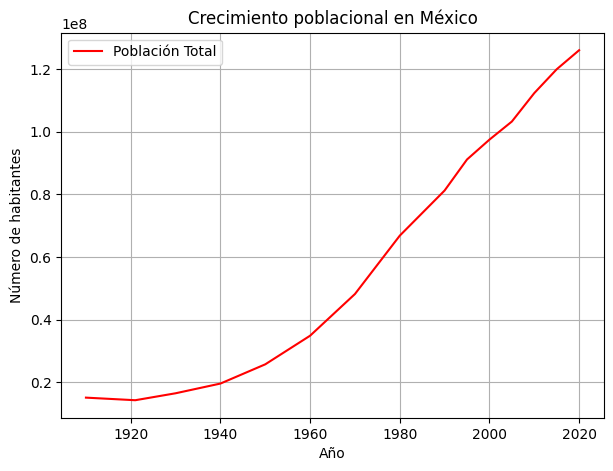

In [12]:
import matplotlib.pyplot as plt

plt.figure(figsize=(7, 5))
plt.plot(periodo, poblacion, color='red', label = 'Población Total')
plt.xlabel('Año')
plt.ylabel('Número de habitantes')
plt.title('Crecimiento poblacional en México')
plt.legend()
plt.grid(True)
plt.show()

Se observa que el número de habitantes presenta crecimiento lineal a partir de 1960

In [13]:
pob = tuple(zip(periodo,poblacion))
filtro = filter(lambda pob: pob[0] >= 1960, pob)
pob = list(filtro)

In [14]:
periodo = []
poblacion = []

for dato in pob:
    periodo.append(dato[0])
    poblacion.append(dato[1])

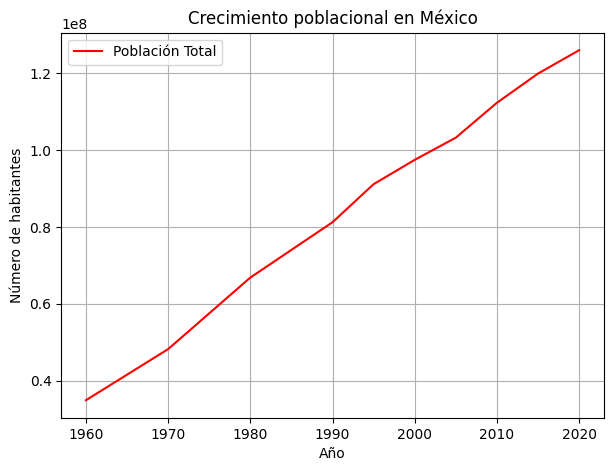

In [15]:
plt.figure(figsize=(7, 5))
plt.plot(periodo, poblacion, color='red', label='Población Total')
plt.xlabel('Año')
plt.ylabel('Número de habitantes')
plt.title('Crecimiento poblacional en México')
plt.legend()
plt.grid(True)
plt.show()

A continuación se obtendrá el coeficiente de determinación para comprobar que el crecimiento es lineal

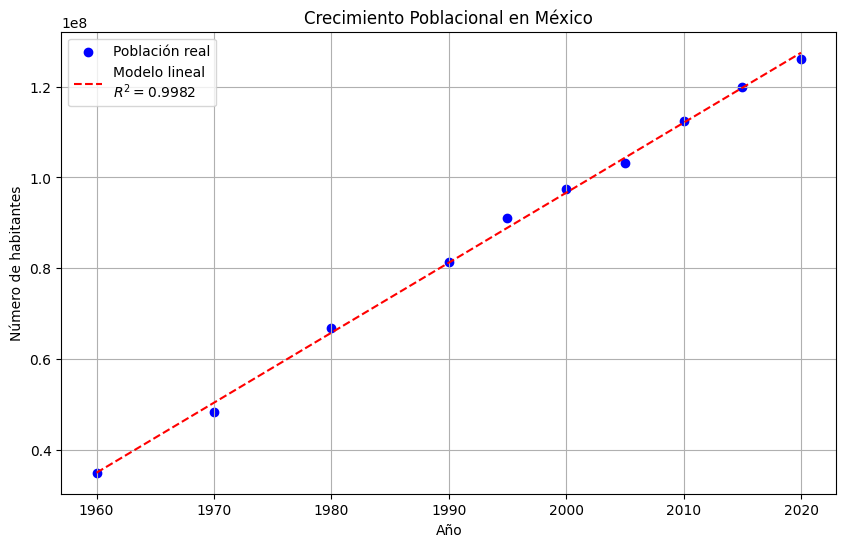

R²: 0.9982


In [16]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

X = np.array(periodo).reshape(-1, 1)
y = np.array(poblacion)


# Crear y entrenar un modelo lineal
model = LinearRegression()
model.fit(X, y)

# Prediccion
y_pred = model.predict(X)

# Calcular R²
r2 = r2_score(y, y_pred)

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X, y, color='blue', label='Población real')
plt.plot(X, y_pred, color='red', linestyle='--', label=f'Modelo lineal\n$R^2 = {r2:.4f}$')
plt.xlabel('Año')
plt.ylabel('Número de habitantes')
plt.title('Crecimiento Poblacional en México')
plt.legend()
plt.grid(True)
plt.savefig('analisis_exp/r2.png', dpi = 200, bbox_inches = 'tight')
plt.show()

print(f'R²: {r2:.4f}')

El coeficiente de determinación es muy cercano a 1, lo que indica que el crecimiento poblacional en el país puede ser aproximado utilizando un modelo lineal.

In [17]:
df_poblacion = pd.read_csv('datos/INEGI/Poblacion_01.csv')
df_poblacion.head()

,Entidad federativa,2010,2020
0,Aguascalientes,1184996,1425607
1,Baja California,3155070,3769020
2,Baja California Sur,637026,798447
3,Campeche,822441,928363
4,Coahuila de Zaragoza,2748391,3146771


Se cuenta con los resultados del censo del INEGI que se realiza cada 10 años, en número de habitantes por estado

Se utilizará un modelo lineal para obtener los datos faltantes en el periodo de 2015 a 2023, considerando los resultados de los dos censos más recientes

In [18]:
rango= [num for num in range(2011, 2024) if num != 2020]

for i in rango:
    df_poblacion[str(i)] = ((df_poblacion['2020']-df_poblacion['2010'])/10)*(i-2010) + df_poblacion['2010']

In [19]:
# Se agrega la columna de clave de entidad
df_poblacion.sort_values('Entidad federativa', inplace=True)
df_poblacion.insert(1, 'Clave_Ent', list(range(1, 33)))

In [20]:
df_poblacion.head() # El indice no es importante en este caso

,Entidad federativa,Clave_Ent,2010,2020,2011,2012,2013,2014,2015,2016,2017,2018,2019,2021,2022,2023
0,Aguascalientes,1,1184996,1425607,1209057.1,1233118.2,1257179.3,1281240.4,1305301.5,1329362.6,1353423.7,1377484.8,1401545.9,1449668.1,1473729.2,1497790.3
1,Baja California,2,3155070,3769020,3216465.0,3277860.0,3339255.0,3400650.0,3462045.0,3523440.0,3584835.0,3646230.0,3707625.0,3830415.0,3891810.0,3953205.0
2,Baja California Sur,3,637026,798447,653168.1,669310.2,685452.3,701594.4,717736.5,733878.6,750020.7,766162.8,782304.9,814589.1,830731.2,846873.3
3,Campeche,4,822441,928363,833033.2,843625.4,854217.6,864809.8,875402.0,885994.2,896586.4,907178.6,917770.8,938955.2,949547.4,960139.6
6,Chiapas,5,4796580,5543828,4871304.8,4946029.6,5020754.4,5095479.2,5170204.0,5244928.8,5319653.6,5394378.4,5469103.2,5618552.8,5693277.6,5768002.4


Se utiliza la función stack( ) para apilar las columnas correspondientes a los años en las filas de entidad federativa

In [21]:
# Apilar los años dentro de cada estado
df_poblacion = df_poblacion.loc[:,'2010':].stack()
# Renombrar las columnas
df_poblacion = df_poblacion.reset_index()
df_poblacion = df_poblacion.rename(columns={'level_0': 'Clave_Ent', 'level_1': 'Año', 0: 'Poblacion'})
df_poblacion['Clave_Ent'] += 1

In [22]:
df_poblacion.head()

,Clave_Ent,Año,Poblacion
0,1,2010,1184996.0
1,1,2020,1425607.0
2,1,2011,1209057.1
3,1,2012,1233118.2
4,1,2013,1257179.3


Debido a que el año proviene de nombres de columnas es necesario convertirlos a tipo numérico

In [23]:
df_poblacion.dtypes

Clave_Ent      int64
Año           object
Poblacion    float64
dtype: object

In [24]:
df_poblacion['Año'] = df_poblacion['Año'].astype(int)
df_poblacion.dtypes

Clave_Ent      int64
Año            int32
Poblacion    float64
dtype: object

Ahora es posible utilizar la función merge( ) para unir esta información con el dataframe principal

In [25]:
df = pd.merge(df, df_poblacion, on=['Clave_Ent', 'Año'], how='inner')

In [26]:
df.head()

,Año,Clave_Ent,Entidad,Tipo de delito,DelitosTotales,Poblacion
0,2015,1,Aguascalientes,Aborto,5.0,1305301.5
1,2015,1,Aguascalientes,Abuso de confianza,419.0,1305301.5
2,2015,1,Aguascalientes,Abuso sexual,18.0,1305301.5
3,2015,1,Aguascalientes,Acoso sexual,0.0,1305301.5
4,2015,1,Aguascalientes,Allanamiento de morada,169.0,1305301.5


Puesto que este último procedimiento se utilizará de manera repetida, se definirá una función que apile y procese cada dataframe de información adicional antes de unirlo con el dataframe principal, así como una función para agregar la columna de clave de entidad

In [27]:
def clave(df):
    df.sort_values('Entidad federativa', inplace=True)
    df.insert(1, 'Clave_Ent', list(range(1, 33)))
    pass

In [28]:
def apilar(df, nombre):
    df_info = df.loc[:,'2015':].stack()
    df_info = df_info.reset_index()
    df_info = df_info.rename(columns={'level_0': 'Clave_Ent', 'level_1': 'Año', 0: nombre})
    df_info['Clave_Ent'] += 1
    df_info['Año'] = df_info['Año'].astype(int)
    return df_info

### Producto Interno Bruto

Se cuenta con una base de datos obtenida del INEGI con el PIB por estado de 1980 a 2022, en millones de pesos a tasa de cambio de 2018

In [29]:
df_pib = pd.read_csv('datos/INEGI/PIBE_r_1.csv')
df_pib.head()

,Concepto,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aguascalientes,74479,82816,83133,78801,82467,84980,81603,84379,86482,...,251657,277675,294497,307396,314242,327926,327058,303556,312954,316500
1,Baja California,400157,451677,446781,406200,425489,437529,402275,414362,417816,...,733754,760857,795081,828692,863601,878817,897460,833361,901664,929459
2,Baja California Sur,53016,57736,58188,57233,59391,60740,59879,61327,62347,...,145216,147614,156072,163095,170784,184618,179624,152597,170695,177421
3,Campeche,511362,560971,559722,523135,546199,566378,548650,570391,588026,...,692550,685992,700311,663239,595667,564591,544914,502567,491694,473101
4,Coahuila de Zaragoza,362299,401420,400947,372296,388156,399779,375949,384636,387781,...,864429,902863,897702,901719,941582,966055,974554,862347,916340,922287


In [30]:
# Se acompletan datos faltantes con la media de los años anteriores
df_pib['2023'] = df_pib.iloc[:, -8:].mean(axis=1)
# Se descartan los años anteriores a 2015
df_pib = df_pib.drop(df_pib.loc[:,'1980':'2014'], axis=1)
# Se agrega la columna Clave_Ent
df_pib.sort_values('Concepto', inplace=True)
df_pib.insert(1, 'Clave_Ent', list(range(1, 33)))

In [31]:
df_pib.head()

,Concepto,Clave_Ent,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aguascalientes,1,294497,307396,314242,327926,327058,303556,312954,316500,313016.125
1,Baja California,2,795081,828692,863601,878817,897460,833361,901664,929459,866016.875
2,Baja California Sur,3,156072,163095,170784,184618,179624,152597,170695,177421,169363.250
3,Campeche,4,700311,663239,595667,564591,544914,502567,491694,473101,567010.500
6,Chiapas,5,364001,369919,359734,353600,349375,334057,349531,368789,356125.750


In [32]:
df_pib = apilar(df_pib, 'PIB')

In [33]:
df_pib.head()

,Clave_Ent,Año,PIB
0,1,2015,294497.0
1,1,2016,307396.0
2,1,2017,314242.0
3,1,2018,327926.0
4,1,2019,327058.0


In [34]:
# Se realiza la union con el dataframe principal
df = pd.merge(df, df_pib, on=['Clave_Ent', 'Año'], how='inner')

### Eficiencia terminal en primaria

Es el porcentaje de alumnos que terminan la educación primaria, respecto a los alumnos de nuevo ingreso al primer grado de educación primaria cinco años antes. Fuente: SNIEG

In [35]:
df_primaria = pd.read_csv('datos/SNIEG/EficienciaTerminal.csv')
df_primaria.head()

,Entidad federativa,2015,2016,2017,2018,2019,2020,2021
0,Aguascalientes,99.48262,99.35626,100.07392,97.48356,98.09545,100.23181,98.33755
1,Baja California,98.14218,98.66109,97.24271,98.01292,98.76864,100.17642,99.27973
2,Baja California Sur,100.85804,100.22020,101.06473,101.19988,101.44480,100.89693,100.91770
3,Campeche,97.12600,95.57463,95.45344,92.90948,92.72780,94.99509,94.89013
4,Coahuila de Zaragoza,98.00489,98.33659,99.06695,97.32727,97.75960,98.07359,99.20941


In [36]:
# Se acompletan datos faltantes utilizando la media
df_primaria['2022'] = df_primaria.iloc[:,-7:].mean(axis=1)
df_primaria['2023'] = df_primaria.iloc[:,-7:].mean(axis=1)
# Se agrega la columna de clave de entidad
clave(df_primaria)

In [37]:
df_primaria.head(3)

,Entidad federativa,Clave_Ent,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aguascalientes,1,99.48262,99.35626,100.07392,97.48356,98.09545,100.23181,98.33755,99.008739,98.941041
1,Baja California,2,98.14218,98.66109,97.24271,98.01292,98.76864,100.17642,99.27973,98.611956,98.679067
2,Baja California Sur,3,100.85804,100.22020,101.06473,101.19988,101.44480,100.89693,100.91770,100.943183,100.955346


In [38]:
df_primaria = apilar(df_primaria, 'EficienciaPrimaria')

In [39]:
df_primaria.head()

,Clave_Ent,Año,EficienciaPrimaria
0,1,2015,99.48262
1,1,2016,99.35626
2,1,2017,100.07392
3,1,2018,97.48356
4,1,2019,98.09545


In [40]:
# Se realiza la union con el dataframe principal
df = pd.merge(df, df_primaria, on=['Clave_Ent', 'Año'], how='inner')

### Eficiencia terminal en secundaria

Es el porcentaje de alumnos que terminan la educación secundaria, respecto a los alumnos que ingresaron al primer grado de educación secundaria dos ciclos escolares antes. Fuente: SNIEG

In [41]:
df_sec = pd.read_csv('datos/SNIEG/Secundaria.csv')
df_sec.head()

,Entidad federativa,2015,2016,2017,2018,2019,2020,2021
0,Aguascalientes,83.13134,81.94596,82.61587,82.21347,86.10915,91.06960,89.92814
1,Baja California,85.34541,85.48487,86.82932,87.08663,90.89073,92.44412,94.74835
2,Baja California Sur,85.19199,90.02490,91.06219,92.09745,95.59075,95.68099,95.55604
3,Campeche,77.06601,82.07443,82.95027,83.00678,87.08686,89.38409,89.05945
4,Coahuila de Zaragoza,85.83391,87.55983,87.28182,87.89882,89.20232,91.72750,92.90973


In [42]:
# Acompletar datos faltantes
df_sec['2022'] = df_sec.iloc[:,-7:].mean(axis=1)
df_sec['2023'] = df_sec.iloc[:,-7:].mean(axis=1)
# Agregat clave de entidad
clave(df_sec)

In [43]:
df_sec.head(3)

,Entidad federativa,Clave_Ent,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aguascalientes,1,83.13134,81.94596,82.61587,82.21347,86.10915,91.06960,89.92814,85.287647,85.595691
1,Baja California,2,85.34541,85.48487,86.82932,87.08663,90.89073,92.44412,94.74835,88.975633,89.494236
2,Baja California Sur,3,85.19199,90.02490,91.06219,92.09745,95.59075,95.68099,95.55604,92.172044,93.169195


In [44]:
df_sec = apilar(df_sec, 'EficienciaSecundaria')

In [45]:
df_sec.head()

,Clave_Ent,Año,EficienciaSecundaria
0,1,2015,83.13134
1,1,2016,81.94596
2,1,2017,82.61587
3,1,2018,82.21347
4,1,2019,86.10915


In [46]:
# Unir con el df principal
df = pd.merge(df, df_sec, on=['Clave_Ent', 'Año'], how='inner')

### Eficiencia terminal en educación media superior

Número de alumnos que egresan de un determinado nivel educativo en un ciclo escolar, por cada 100 alumnos inscritos en la cohorte escolar inicial del mismo nivel. Cuando el programa tiene una duración de tres ciclos anuales, periodicidad típica del tipo educativo, dicha generación escolar se compone de los alumnos de nuevo ingreso matriculados en el primer grado de educación media superior dos ciclos previos al de referencia. Fuente: SNIEG

Se utilizará el término bachillerato para las variables de este dataframe, sin embargo se señala que estos valores incluyen todo
todo tipo de educación media superior, incluyendo carreras técnicas.

In [47]:
df_bach = pd.read_csv('datos/SNIEG/Bachillerato.csv')
df_bach.head()

,Entidad federativa,2015,2016,2017,2018,2019,2020,2021
0,Aguascalientes,66.79740,65.49610,63.22785,70.71130,68.90834,65.80879,74.11692
1,Baja California,59.74364,61.45278,64.94015,62.59579,65.50741,61.97831,62.35608
2,Baja California Sur,63.96079,67.42148,64.53694,71.42028,71.95624,69.42136,64.35048
3,Campeche,62.07971,62.10151,60.03409,57.74783,67.91440,63.27214,65.04800
4,Coahuila de Zaragoza,61.48799,65.13761,64.06380,69.83528,65.25873,65.58304,62.00391


In [48]:
# Rellenar datos faltantes
df_bach['2022'] = df_bach.iloc[:,-7:].mean(axis=1)
df_bach['2023'] = df_bach.iloc[:,-7:].mean(axis=1)
# Agregar clave de entidad
clave(df_bach)

In [49]:
df_bach.head(3)

,Entidad federativa,Clave_Ent,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aguascalientes,1,66.79740,65.49610,63.22785,70.71130,68.90834,65.80879,74.11692,67.866671,68.019424
1,Baja California,2,59.74364,61.45278,64.94015,62.59579,65.50741,61.97831,62.35608,62.653451,63.069139
2,Baja California Sur,3,63.96079,67.42148,64.53694,71.42028,71.95624,69.42136,64.35048,67.581081,68.098266


In [50]:
df_bach = apilar(df_bach, 'EficienciaBachillerato')

In [51]:
# Unir con el df principal
df = pd.merge(df, df_bach, on=['Clave_Ent', 'Año'], how='inner')

### Tasa de desocupación

Porcentaje que representa la población desocupada respecto a la población económicamente activa (PEA calculada con la población de 15 años y más). Fuente: SNIEG

In [52]:
df_desoc = pd.read_csv('datos/SNIEG/TasaDesocupacion.CSV')
df_desoc.head()

,Entidad federativa,Indicador,2015/01,2015/02,2015/03,2015/04,2016/01,2016/02,2016/03,2016/04,...,2021/03,2021/04,2022/01,2022/02,2022/03,2022/04,2023/01,2023/02,2023/03,2023/04
0,Aguascalientes,Total,4.51319,4.45453,4.97942,4.06616,3.99321,4.06091,3.95252,3.88478,...,4.62574,4.37726,3.51969,3.76820,4.03923,3.76756,3.01962,3.19796,3.17738,3.50581
1,Aguascalientes,Hombre,4.79226,4.78432,5.28620,4.63120,4.05716,4.31522,3.96963,4.12687,...,5.19527,4.63061,3.65715,3.54682,4.16140,3.99051,3.33566,3.50895,3.62514,4.04742
2,Aguascalientes,Mujer,4.04405,3.89903,4.46440,3.14035,3.89096,3.66441,3.92586,3.51037,...,3.74571,3.99495,3.30649,4.10019,3.86140,3.45060,2.58592,2.75635,2.55413,2.72317
3,Baja California,Total,4.21158,4.78652,3.90197,3.77257,2.92339,2.50304,3.00825,2.31747,...,2.87954,2.04351,1.91049,2.50984,2.59254,2.70224,1.71222,2.30743,2.43889,2.24539
4,Baja California,Hombre,4.21213,5.50004,3.92016,4.17383,2.71405,2.67752,3.04589,2.38940,...,2.82612,2.44352,2.34971,2.97108,2.69044,2.93393,1.87172,2.32333,2.63221,2.17828


In [53]:
# Se filtra el desglose por genero
df_desoc = df_desoc[df_desoc['Indicador'] == 'Total']
# Se descartan columnas innecesarias
df_desoc = df_desoc.drop('Indicador', axis=1)
df_desoc = df_desoc.reset_index().drop('index', axis=1)

In [54]:
df_desoc.isnull().any().any()

True

In [55]:
df_desoc.loc[:,'2019/01':].head(3)

,2019/01,2019/02,2019/03,2019/04,2020/01,2020/02,2020/03,2020/04,2021/01,2021/02,2021/03,2021/04,2022/01,2022/02,2022/03,2022/04,2023/01,2023/02,2023/03,2023/04
0,3.28535,3.67106,3.79282,3.34141,3.35009,NaN,5.19230,5.19754,3.62242,3.87156,4.62574,4.37726,3.51969,3.76820,4.03923,3.76756,3.01962,3.19796,3.17738,3.50581
1,2.51192,2.55760,2.89908,2.21851,2.16798,NaN,2.74817,2.88007,2.55476,2.44667,2.87954,2.04351,1.91049,2.50984,2.59254,2.70224,1.71222,2.30743,2.43889,2.24539
2,3.95454,4.61803,4.94592,4.37215,3.83703,NaN,7.38778,5.42497,4.98176,4.40950,4.25482,2.59220,2.87475,2.73295,2.86790,2.85079,2.75936,2.70070,3.18616,2.26334


Se observa que esta base de datos tiene datos faltantes correspondientes al segundo trimestre del 2020

In [56]:
# Se acompletan datos faltantes
df_desoc = df_desoc.fillna(method = 'ffill', axis=1)
df_desoc.loc[:,'2019/01':].head(3)

,2019/01,2019/02,2019/03,2019/04,2020/01,2020/02,2020/03,2020/04,2021/01,2021/02,2021/03,2021/04,2022/01,2022/02,2022/03,2022/04,2023/01,2023/02,2023/03,2023/04
0,3.28535,3.67106,3.79282,3.34141,3.35009,3.35009,5.1923,5.19754,3.62242,3.87156,4.62574,4.37726,3.51969,3.7682,4.03923,3.76756,3.01962,3.19796,3.17738,3.50581
1,2.51192,2.5576,2.89908,2.21851,2.16798,2.16798,2.74817,2.88007,2.55476,2.44667,2.87954,2.04351,1.91049,2.50984,2.59254,2.70224,1.71222,2.30743,2.43889,2.24539
2,3.95454,4.61803,4.94592,4.37215,3.83703,3.83703,7.38778,5.42497,4.98176,4.4095,4.25482,2.5922,2.87475,2.73295,2.8679,2.85079,2.75936,2.7007,3.18616,2.26334


Estos datos representan porcentajes por trimestre. Se modificará el dataframe para obtener el promedio anual

In [57]:
# Obtener la media anual y eliminar las columnas trimestrales
for i in range(1,10):
    year = 2024-i
    df_desoc.insert(1, str(year), df_desoc.iloc[:,-4:].mean(axis=1))
    df_desoc.drop(df_desoc.iloc[:,-4:], axis=1, inplace=True)
# Agregar la clave de la entidad
clave(df_desoc)

In [58]:
df_desoc.head()

,Entidad federativa,Clave_Ent,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aguascalientes,1,4.503325,3.972855,3.630322,3.4501,3.52266,4.272505,4.124245,3.77367,3.225192
1,Baja California,2,4.16816,2.688038,2.852475,2.51368,2.546778,2.49105,2.48112,2.428777,2.175982
2,Baja California Sur,3,4.786112,4.60931,4.35683,3.782522,4.47266,5.121702,4.05957,2.831597,2.72739
3,Campeche,4,2.884725,3.702132,3.803275,3.26537,3.296257,3.195207,2.958625,2.57388,1.76395
6,Chiapas,5,3.093762,3.062107,2.574955,2.78294,3.214,2.82313,3.174185,2.426007,2.135168


In [59]:
df_desoc = apilar(df_desoc, 'Desocupacion')

In [60]:
df_desoc.head()

,Clave_Ent,Año,Desocupacion
0,1,2015,4.503325
1,1,2016,3.972855
2,1,2017,3.630322
3,1,2018,3.4501
4,1,2019,3.52266


In [61]:
# Unir al df principal
df = pd.merge(df, df_desoc, on=['Clave_Ent', 'Año'], how='inner')

### Mediana del ingreso mensual real de la población de 15 a 29 años ocupada

Es el corte en el cual se encuentra la mediana del ingreso real mensual de la población de 15 a 29 años ocupada. Fuente: SNIEG

In [62]:
df_salarios = pd.read_csv('datos/SNIEG/Salarios.csv')
df_salarios.head()

,Entidad federativa,2015/01,2015/02,2015/03,2015/04,2016/01,2016/02,2016/03,2016/04,2017/01,...,2021/02,2021/03,2021/04,2022/01,2022/02,2022/03,2022/04,2023/01,2023/02,2023/03
0,Aguascalientes,4431.02378,4589.18542,4915.81919,4850.78744,4794.21727,4810.29322,4782.66687,4698.39196,4566.83803,...,5349.09827,5590.00766,5163.64406,5418.01300,5317.76022,5211.11057,5122.42191,5378.20732,5533.44373,5644.83123
1,Baja California,5169.52775,5426.71175,5407.40111,5335.86619,5753.06073,5676.14599,5739.20025,5638.07035,5480.20564,...,6877.41206,7162.85486,6861.98546,7224.01734,7090.34696,7295.55480,7171.39068,7817.16180,8384.00566,8301.22240
2,Baja California Sur,5908.03171,5920.04919,5898.98302,5820.94493,6107.05235,6253.38118,6217.46693,6555.89575,6372.33214,...,6113.25516,6785.86249,7007.80265,6720.01613,6430.77980,6948.14743,6829.89588,7296.53882,7279.65663,7207.77767
3,Campeche,4431.02378,4440.03689,4424.23727,4365.70870,4459.73700,4329.26389,4304.40018,4463.47236,4338.49613,...,3998.49538,4146.91597,4288.74091,4334.41040,4254.20818,4189.89449,4302.83441,4705.93140,4853.36439,4980.73344
4,Coahuila de Zaragoza,5169.52775,5180.04304,5293.07973,5335.86619,5496.62585,5593.36420,5739.20025,5638.07035,5480.20564,...,5731.17671,5654.88541,5558.20822,5880.01411,6026.79492,6253.33269,6146.90630,6386.62119,6707.20453,6640.97792


In [63]:
# Se buscan datos faltantes
df_salarios.isnull().any().any()

True

In [64]:
# Se revisa la ubicacion de los datos faltantes
df_salarios.loc[:,'2019/01':].head(3)

,2019/01,2019/02,2019/03,2019/04,2020/01,2020/02,2020/03,2020/04,2021/01,2021/02,2021/03,2021/04,2022/01,2022/02,2022/03,2022/04,2023/01,2023/02,2023/03
0,4998.98277,4992.53378,4972.71112,4902.10049,4872.35066,NaN,4786.27193,5322.71238,5406.36329,5349.09827,5590.00766,5163.64406,5418.01300,5317.76022,5211.11057,5122.42191,5378.20732,5533.44373,5644.83123
1,6248.72846,6240.66722,6215.88890,6127.62562,6043.58880,NaN,6780.55191,7103.06790,6974.20864,6877.41206,7162.85486,6861.98546,7224.01734,7090.34696,7295.55480,7171.39068,7817.16180,8384.00566,8301.22240
2,6248.72846,6240.66722,6215.88890,6536.13399,6043.58880,NaN,5982.83992,6589.15084,5811.84054,6113.25516,6785.86249,7007.80265,6720.01613,6430.77980,6948.14743,6829.89588,7296.53882,7279.65663,7207.77767


In [65]:
# Rellenar datos faltantes
df_salarios['2023/04'] = None
df_salarios = df_salarios.fillna(method = 'ffill', axis=1)

In [66]:
df_salarios.loc[:,'2019/01':].head(3)

,2019/01,2019/02,2019/03,2019/04,2020/01,2020/02,2020/03,2020/04,2021/01,2021/02,2021/03,2021/04,2022/01,2022/02,2022/03,2022/04,2023/01,2023/02,2023/03,2023/04
0,4998.98277,4992.53378,4972.71112,4902.10049,4872.35066,4872.35066,4786.27193,5322.71238,5406.36329,5349.09827,5590.00766,5163.64406,5418.013,5317.76022,5211.11057,5122.42191,5378.20732,5533.44373,5644.83123,5644.83123
1,6248.72846,6240.66722,6215.8889,6127.62562,6043.5888,6043.5888,6780.55191,7103.0679,6974.20864,6877.41206,7162.85486,6861.98546,7224.01734,7090.34696,7295.5548,7171.39068,7817.1618,8384.00566,8301.2224,8301.2224
2,6248.72846,6240.66722,6215.8889,6536.13399,6043.5888,6043.5888,5982.83992,6589.15084,5811.84054,6113.25516,6785.86249,7007.80265,6720.01613,6430.7798,6948.14743,6829.89588,7296.53882,7279.65663,7207.77767,7207.77767


In [67]:
# Obtener la media anual y eliminar las columnas trimestrales
for i in range(1,10):
    year = 2024-i
    df_salarios.insert(1, str(year), df_salarios.iloc[:,-4:].mean(axis=1))
    df_salarios.drop(df_salarios.iloc[:,-4:], axis=1, inplace=True)
# Agregar la clave de la entidad
clave(df_salarios)

In [68]:
df_salarios.head()

,Entidad federativa,Clave_Ent,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aguascalientes,1,4696.703957,4771.39233,4614.24284,4966.150688,4966.58204,4963.421407,5377.27832,5267.326425,5550.328377
1,Baja California,2,5334.8767,5701.61933,5510.163207,5681.770567,6208.22755,6492.699352,6969.115255,7195.327445,8200.903065
2,Baja California Sur,3,5887.002212,6283.449053,6400.278015,6217.772665,6310.354643,6164.79209,6429.69021,6732.20981,7247.937697
3,Campeche,4,4415.25166,4389.218357,4182.232073,4164.63005,4138.818365,4302.47102,4122.231182,4270.33687,4880.190668
6,Chiapas,5,3006.602408,2862.835395,3114.282063,3255.316548,3756.42237,3596.679385,4004.329775,3299.327153,4006.787928


In [69]:
df_salarios = apilar(df_salarios, 'MedianaSalarios')

In [70]:
df_salarios.head()

,Clave_Ent,Año,MedianaSalarios
0,1,2015,4696.703957
1,1,2016,4771.39233
2,1,2017,4614.24284
3,1,2018,4966.150688
4,1,2019,4966.58204


In [71]:
# Unir al df principal
df = pd.merge(df, df_salarios, on=['Clave_Ent', 'Año'], how='inner')

### Pobreza

Porcentaje de población cuyo ingreso es inferior al valor de la línea de bienestar y que padece al menos una carencia social. Fuente: SNIEG

In [72]:
df_pobreza = pd.read_csv('datos/SNIEG/Pobreza.csv')
df_pobreza.head()

,Entidad federativa,2014,2015,2016,2018,2020,2022
0,Aguascalientes,34.76592,NaN,28.94648,26.26541,27.62669,23.72232
1,Baja California,28.59798,NaN,22.60487,23.59869,22.51012,13.37082
2,Baja California Sur,30.26271,NaN,22.88005,18.57216,27.60222,13.32903
3,Campeche,43.58780,NaN,45.66019,48.96430,50.54915,45.12944
4,Coahuila de Zaragoza,30.17138,NaN,27.05571,25.50771,25.61704,18.24332


In [73]:
# Rellenar datos faltantes
df_pobreza.insert(4, '2017', None)
df_pobreza.insert(6, '2019', None)
df_pobreza.insert(8, '2021', None)
df_pobreza.insert(10, '2023', None)
df_pobreza = df_pobreza.fillna(method = 'ffill', axis=1)
# Descartar columnas innecesarias
df_pobreza = df_pobreza.drop('2014', axis = 1)
# Insertar clave de entidad
clave(df_pobreza)

In [74]:
df_pobreza.head(3)

,Entidad federativa,Clave_Ent,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aguascalientes,1,34.76592,28.94648,28.94648,26.26541,26.26541,27.62669,27.62669,23.72232,23.72232
1,Baja California,2,28.59798,22.60487,22.60487,23.59869,23.59869,22.51012,22.51012,13.37082,13.37082
2,Baja California Sur,3,30.26271,22.88005,22.88005,18.57216,18.57216,27.60222,27.60222,13.32903,13.32903


In [75]:
df_pobreza = apilar(df_pobreza, 'Pobreza')

In [76]:
df_pobreza.head()

,Clave_Ent,Año,Pobreza
0,1,2015,34.76592
1,1,2016,28.94648
2,1,2017,28.94648
3,1,2018,26.26541
4,1,2019,26.26541


In [77]:
# Unir con el df principal
df = pd.merge(df, df_pobreza, on=['Clave_Ent', 'Año'], how='inner')

### Medicos por cada cien mil habitantes

Número de médicos (generales, especialistas, pasantes, internos y residentes) en contacto con el paciente en (de) instituciones públicas de salud, por cada mil habitantes, en un año y área geográfica determinados. El nombre es el utilizado a nivel internacional, aunque el indicador solo haga referencia a los médicos en instituciones públicas, (SNIEG).

In [78]:
df_med = pd.read_csv('datos/SNIEG/Medicos.csv')
df_med.head()

,Entidad federativa,2015,2016,2017,2018,2019,2020,2021,2022
0,Aguascalientes,1.90087,1.98550,2.16623,2.06086,2.15200,2.13729,2.20148,2.23791
1,Baja California,1.58419,1.59542,1.58135,1.49628,1.52373,1.55889,1.54347,1.48371
2,Baja California Sur,2.33295,2.43296,2.36968,2.36669,2.44686,2.39971,2.41515,2.37040
3,Campeche,2.05327,2.15508,2.14011,2.49056,2.40656,2.42233,2.33093,2.38935
4,Coahuila de Zaragoza,1.80359,1.79146,1.82280,1.85342,1.91401,1.87481,1.92183,1.93606


In [79]:
# Acompletar datos
df_med['2023'] = df_med.iloc[:,-7:].mean(axis=1)
# Agregar clave de entidad
clave(df_med)

In [80]:
df_med.head(3)

,Entidad federativa,Clave_Ent,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aguascalientes,1,1.90087,1.98550,2.16623,2.06086,2.15200,2.13729,2.20148,2.23791,2.134467
1,Baja California,2,1.58419,1.59542,1.58135,1.49628,1.52373,1.55889,1.54347,1.48371,1.540407
2,Baja California Sur,3,2.33295,2.43296,2.36968,2.36669,2.44686,2.39971,2.41515,2.37040,2.400207


In [81]:
df_med = apilar(df_med, 'MedicosPorPob')

In [82]:
df_med.head()

,Clave_Ent,Año,MedicosPorPob
0,1,2015,1.90087
1,1,2016,1.98550
2,1,2017,2.16623
3,1,2018,2.06086
4,1,2019,2.15200


In [83]:
df = pd.merge(df, df_med, on=['Clave_Ent', 'Año'], how='inner')

### Tasa de internamiento

Es el número de adolescentes entre 14 y 17 años de edad que fueron ingresados durante el año en los centros de tratamiento o internamiento, respecto a la población adolescente por cien mil, (SNIEG)

In [84]:
df_inter = pd.read_csv('datos/SNIEG/Internamiento.csv')
df_inter.head()

,Entidad federativa,Indicador,2015,2016,2017,2018,2019,2020,2021
0,Aguascalientes,Total,68.36443,19.80594,17.79448,24.64357,46.26440,38.50090,74.48732
1,Aguascalientes,Hombre,117.22097,35.08417,33.01575,48.32736,84.80174,69.50031,135.83012
2,Aguascalientes,Mujer,18.09253,4.02620,2.01352,0.00000,6.03570,6.06085,10.17225
3,Baja California,Total,265.21865,119.32123,65.65194,43.79792,29.34212,26.49739,47.77212
4,Baja California,Hombre,495.70787,220.23745,122.19030,75.12574,55.33952,48.92393,88.31521


In [85]:
# Filtrar el desglose por genero
df_inter = df_inter[df_inter['Indicador'] == 'Total']
# Descartar columnas innecesarias
df_inter = df_inter.drop('Indicador', axis=1)
df_inter = df_inter.reset_index().drop('index', axis=1)
# Acompletar la informacion
df_inter['2022'] = df_inter.iloc[:,-6:].mean(axis=1)
df_inter['2023'] = df_inter.iloc[:,-6:].mean(axis=1)
# Agregar clave de entidad
clave(df_inter)

In [86]:
df_inter.head(3)

,Entidad federativa,Clave_Ent,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aguascalientes,1,68.36443,19.80594,17.79448,24.64357,46.26440,38.50090,74.48732,36.916102,39.767795
1,Baja California,2,265.21865,119.32123,65.65194,43.79792,29.34212,26.49739,47.77212,55.397120,44.743102
2,Baja California Sur,3,37.16185,25.49180,14.27358,6.99187,5.13899,5.03907,3.29612,10.038572,7.463034


In [87]:
df_inter = apilar(df_inter, 'Internamiento')

In [88]:
df_inter.head()

,Clave_Ent,Año,Internamiento
0,1,2015,68.36443
1,1,2016,19.80594
2,1,2017,17.79448
3,1,2018,24.64357
4,1,2019,46.26440


In [89]:
df = pd.merge(df, df_inter, on=['Clave_Ent', 'Año'], how='inner')

Al final se tiene el dataframe con diez parámetros adicionales

In [90]:
df

,Año,Clave_Ent,Entidad,Tipo de delito,DelitosTotales,Poblacion,PIB,EficienciaPrimaria,EficienciaSecundaria,EficienciaBachillerato,Desocupacion,MedianaSalarios,Pobreza,MedicosPorPob,Internamiento
0,2015,1,Aguascalientes,Aborto,5.0,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430
1,2015,1,Aguascalientes,Abuso de confianza,419.0,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430
2,2015,1,Aguascalientes,Abuso sexual,18.0,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430
3,2015,1,Aguascalientes,Acoso sexual,0.0,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430
4,2015,1,Aguascalientes,Allanamiento de morada,169.0,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11515,2023,32,Zacatecas,Tráfico de menores,0.0,1661579.0,218885.5,96.367071,83.92729,64.384151,2.872008,4632.086025,44.21589,1.932931,67.359207
11516,2023,32,Zacatecas,Violación equiparada,129.0,1661579.0,218885.5,96.367071,83.92729,64.384151,2.872008,4632.086025,44.21589,1.932931,67.359207
11517,2023,32,Zacatecas,Violación simple,161.0,1661579.0,218885.5,96.367071,83.92729,64.384151,2.872008,4632.086025,44.21589,1.932931,67.359207
11518,2023,32,Zacatecas,Violencia de género en todas sus modalidades d...,0.0,1661579.0,218885.5,96.367071,83.92729,64.384151,2.872008,4632.086025,44.21589,1.932931,67.359207


## Agregar nuevos parámetros a partir de existentes

Suele preferise tener el número de delitos en función de la población, por lo que se agrega el total de delitos por cada cien mil habitantes, así como el PIB per cápita

In [91]:
df.insert(5, 'DelitosPorPob', df.iloc[:,4]*100_000/df.iloc[:,5])
df['PIBPerCapita'] = df['PIB']*1_000_000/df['Poblacion']

In [92]:
df

,Año,Clave_Ent,Entidad,Tipo de delito,DelitosTotales,DelitosPorPob,Poblacion,PIB,EficienciaPrimaria,EficienciaSecundaria,EficienciaBachillerato,Desocupacion,MedianaSalarios,Pobreza,MedicosPorPob,Internamiento,PIBPerCapita
0,2015,1,Aguascalientes,Aborto,5.0,0.383053,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430,225616.074141
1,2015,1,Aguascalientes,Abuso de confianza,419.0,32.099864,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430,225616.074141
2,2015,1,Aguascalientes,Abuso sexual,18.0,1.378992,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430,225616.074141
3,2015,1,Aguascalientes,Acoso sexual,0.0,0.000000,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430,225616.074141
4,2015,1,Aguascalientes,Allanamiento de morada,169.0,12.947200,1305301.5,294497.0,99.482620,83.13134,66.797400,4.503325,4696.703957,34.76592,1.900870,68.364430,225616.074141
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11515,2023,32,Zacatecas,Tráfico de menores,0.0,0.000000,1661579.0,218885.5,96.367071,83.92729,64.384151,2.872008,4632.086025,44.21589,1.932931,67.359207,131733.429467
11516,2023,32,Zacatecas,Violación equiparada,129.0,7.763699,1661579.0,218885.5,96.367071,83.92729,64.384151,2.872008,4632.086025,44.21589,1.932931,67.359207,131733.429467
11517,2023,32,Zacatecas,Violación simple,161.0,9.689578,1661579.0,218885.5,96.367071,83.92729,64.384151,2.872008,4632.086025,44.21589,1.932931,67.359207,131733.429467
11518,2023,32,Zacatecas,Violencia de género en todas sus modalidades d...,0.0,0.000000,1661579.0,218885.5,96.367071,83.92729,64.384151,2.872008,4632.086025,44.21589,1.932931,67.359207,131733.429467


In [93]:
# Se guarda el dataset procesado
df.to_csv('DataSet.csv', index=False) 

# Análisis Exploratorio

A continuación se explorará el dataset para obtener información y posibles correlaciones existentes

In [94]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt
import seaborn as sns

## Descripción general

In [95]:
df.describe()

,Año,Clave_Ent,DelitosTotales,DelitosPorPob,Poblacion,PIB,EficienciaPrimaria,EficienciaSecundaria,EficienciaBachillerato,MedicosPorPob,Internamiento,PIBPerCapita
count,11520.000000,11520.000000,11520.000000,11520.000000,1.152000e+04,1.152000e+04,11520.000000,11520.000000,11520.000000,11520.000000,11520.000000,11520.000000
mean,2019.000000,16.500000,1529.792708,39.010718,3.895196e+06,7.332067e+05,97.447262,87.487773,65.782522,1.916958,35.652220,197795.963892
std,2.582101,9.233493,6577.924085,110.113282,3.199966e+06,7.005242e+05,3.128534,4.261824,5.046194,0.493132,49.066324,105334.442605
min,2015.000000,1.000000,0.000000,0.000000,6.909730e+05,1.330240e+05,88.390600,73.726800,49.446970,1.258920,0.290420,60257.461090
25%,2017.000000,8.750000,7.000000,0.267954,1.810695e+06,3.119608e+05,95.358468,85.068005,62.640006,1.579554,8.663032,130000.447069
50%,2019.000000,16.500000,121.000000,4.217491,3.001168e+06,5.189475e+05,97.291441,87.475887,65.838139,1.805595,19.822910,179347.360627
75%,2021.000000,24.250000,764.000000,23.214454,4.943693e+06,8.517938e+05,99.253283,90.311480,68.578310,2.129294,41.330135,229791.981851
max,2023.000000,32.000000,168652.000000,1548.621257,1.753738e+07,3.694575e+06,104.726920,104.834730,93.519200,4.191220,338.755680,799987.891277


In [96]:
df.shape

(11520, 17)

array([[<Axes: title={'center': 'DelitosTotales'}>,
        <Axes: title={'center': 'DelitosPorPob'}>,
        <Axes: title={'center': 'Poblacion'}>],
       [<Axes: title={'center': 'PIB'}>,
        <Axes: title={'center': 'EficienciaPrimaria'}>,
        <Axes: title={'center': 'EficienciaSecundaria'}>],
       [<Axes: title={'center': 'EficienciaBachillerato'}>,
        <Axes: title={'center': 'MedicosPorPob'}>,
        <Axes: title={'center': 'Internamiento'}>],
       [<Axes: title={'center': 'PIBPerCapita'}>, <Axes: >, <Axes: >]],
      dtype=object)

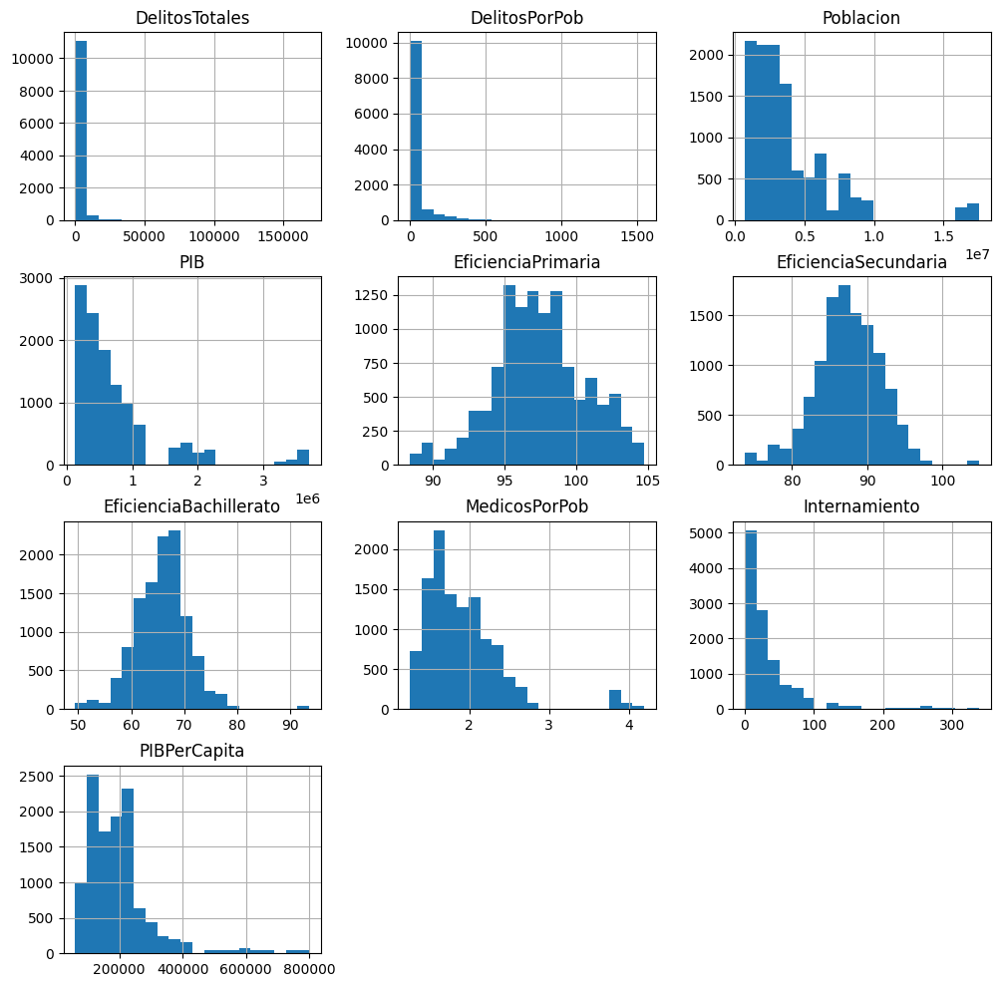

In [97]:
df.iloc[:,4:].hist(bins = 20, figsize = (12,12))

In [98]:
df.head(3)

,Año,Clave_Ent,Entidad,Tipo de delito,DelitosTotales,DelitosPorPob,Poblacion,PIB,EficienciaPrimaria,EficienciaSecundaria,EficienciaBachillerato,Desocupacion,MedianaSalarios,Pobreza,MedicosPorPob,Internamiento,PIBPerCapita
0,2015,1,Aguascalientes,Aborto,5.0,0.383053,1305301.5,294497.0,99.48262,83.13134,66.7974,4.503325,4696.703957,34.76592,1.90087,68.36443,225616.074141
1,2015,1,Aguascalientes,Abuso de confianza,419.0,32.099864,1305301.5,294497.0,99.48262,83.13134,66.7974,4.503325,4696.703957,34.76592,1.90087,68.36443,225616.074141
2,2015,1,Aguascalientes,Abuso sexual,18.0,1.378992,1305301.5,294497.0,99.48262,83.13134,66.7974,4.503325,4696.703957,34.76592,1.90087,68.36443,225616.074141


In [99]:
df.groupby('Entidad')['DelitosTotales'].sum().sort_values(ascending = False)

Entidad
México                             3204022.0
Ciudad de México                   1926382.0
Jalisco                            1233432.0
Guanajuato                         1137458.0
Baja California                     968871.0
Nuevo León                          774103.0
Veracruz de Ignacio de la Llave     645050.0
Chihuahua                           615767.0
Puebla                              600066.0
Coahuila de Zaragoza                492254.0
Querétaro                           475465.0
Tabasco                             475281.0
Hidalgo                             403730.0
Morelos                             400582.0
San Luis Potosí                     389401.0
Michoacán de Ocampo                 383277.0
Tamaulipas                          374411.0
Quintana Roo                        352039.0
Oaxaca                              321637.0
Aguascalientes                      308913.0
Sonora                              273713.0
Guerrero                            264003.0
Du

In [100]:
def ContarDelitosTotales(estado): return df[df['Entidad'] == estado].groupby('Año')['DelitosTotales'].sum().values

In [101]:
Delitos_Mexico = ContarDelitosTotales('México')
Delitos_CDMX = ContarDelitosTotales('Ciudad de México')
Delitos_Jalisco = ContarDelitosTotales('Jalisco')
Delitos_Yuc = ContarDelitosTotales('Yucatán')
Delitos_Campeche = ContarDelitosTotales('Campeche')
Delitos_Nayarit = ContarDelitosTotales('Nayarit')
Delitos_Tlaxcala = ContarDelitosTotales('Tlaxcala')

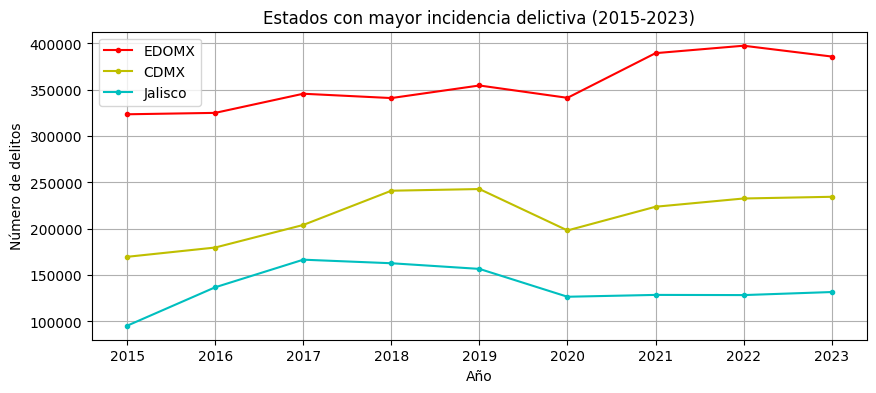

In [102]:
years = list(range(2015,2024))
plt.figure(figsize=(10,4))  
plt.plot(years, Delitos_Mexico, 'r.-',label='EDOMX')
plt.plot(years, Delitos_CDMX, 'y.-',label='CDMX')
plt.plot(years, Delitos_Jalisco, 'c.-', label='Jalisco')
plt.title('Estados con mayor incidencia delictiva (2015-2023)')  
plt.xlabel('Año')
plt.ylabel('Número de delitos')
plt.legend(loc='best')
plt.grid(True)
plt.savefig('analisis_exp/estados1.png', dpi = 200, bbox_inches = 'tight')
plt.show()

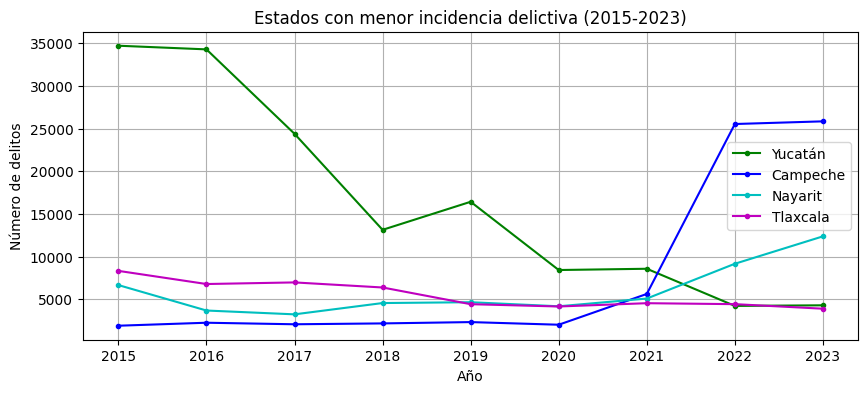

In [103]:
years = list(range(2015,2024))
plt.figure(figsize=(10,4))  
plt.plot(years, Delitos_Yuc, 'g.-',label='Yucatán')
plt.plot(years, Delitos_Campeche, 'b.-',label='Campeche')
plt.plot(years, Delitos_Nayarit, 'c.-', label='Nayarit')
plt.plot(years, Delitos_Tlaxcala, 'm.-', label='Tlaxcala')
plt.title('Estados con menor incidencia delictiva (2015-2023)')  
plt.xlabel('Año')
plt.ylabel('Número de delitos')
plt.legend(loc='best')
plt.grid(True)
plt.savefig('analisis_exp/estados2.png', dpi = 200, bbox_inches = 'tight')
plt.show()

In [104]:
df.groupby('Entidad')['DelitosPorPob'].sum().sort_values(ascending = False)

Entidad
Colima                             28253.623373
Baja California                    26196.946689
Baja California Sur                25256.394833
Aguascalientes                     21931.199282
Ciudad de México                   20982.532589
Morelos                            20546.752182
Querétaro                          20446.799353
Tabasco                            19962.225661
Quintana Roo                       19237.728700
México                             19038.591645
Guanajuato                         18604.172253
Chihuahua                          16588.769466
Coahuila de Zaragoza               15826.245274
Jalisco                            14965.675955
Durango                            14530.133170
San Luis Potosí                    13836.395977
Nuevo León                         13623.015489
Hidalgo                            13214.857444
Zacatecas                          12223.610322
Tamaulipas                         10712.322397
Sonora                          

In [105]:
def ContarDelitosPorPob(estado): return df[df['Entidad'] == estado].groupby('Año')['DelitosPorPob'].sum().values

In [106]:
Delitos_Colima = ContarDelitosPorPob('Colima')
Delitos_BC = ContarDelitosPorPob('Baja California')
Delitos_BCS = ContarDelitosPorPob('Baja California Sur')
Delitos_Yuc = ContarDelitosPorPob('Yucatán')
Delitos_Chiapas = ContarDelitosPorPob('Chiapas')
Delitos_Nayarit = ContarDelitosPorPob('Nayarit')
Delitos_Tlaxcala = ContarDelitosPorPob('Tlaxcala')

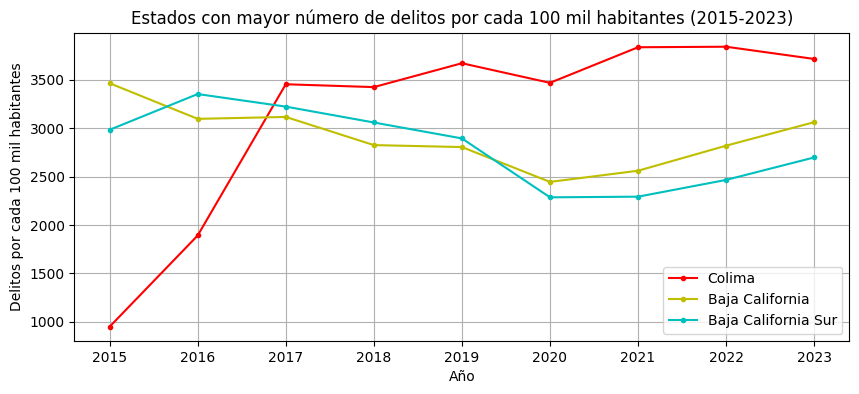

In [107]:
years = list(range(2015,2024))
plt.figure(figsize=(10,4))  
plt.plot(years, Delitos_Colima, 'r.-',label='Colima')
plt.plot(years, Delitos_BC, 'y.-',label='Baja California')
plt.plot(years, Delitos_BCS, 'c.-', label='Baja California Sur')
plt.title('Estados con mayor número de delitos por cada 100 mil habitantes (2015-2023)')  
plt.xlabel('Año')
plt.ylabel('Delitos por cada 100 mil habitantes')
plt.legend(loc='best')
plt.grid(True)
plt.savefig('analisis_exp/estados3.png', dpi = 200, bbox_inches = 'tight')
plt.show()

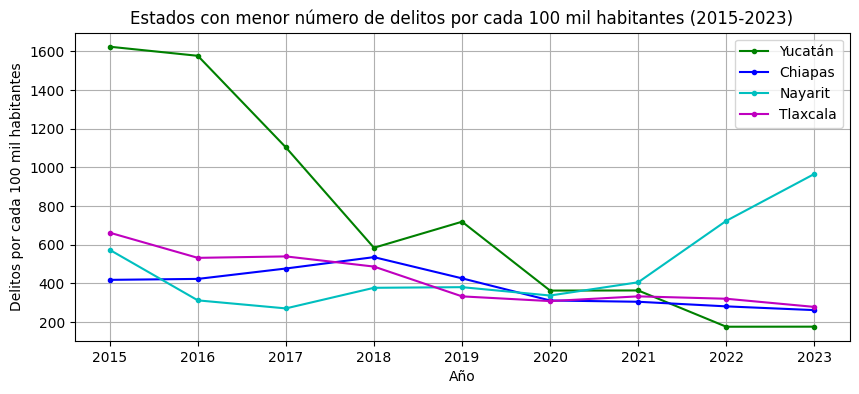

In [108]:
years = list(range(2015,2024))
plt.figure(figsize=(10,4))  
plt.plot(years, Delitos_Yuc, 'g.-',label='Yucatán')
plt.plot(years, Delitos_Chiapas, 'b.-',label='Chiapas')
plt.plot(years, Delitos_Nayarit, 'c.-', label='Nayarit')
plt.plot(years, Delitos_Tlaxcala, 'm.-', label='Tlaxcala')
plt.title('Estados con menor número de delitos por cada 100 mil habitantes (2015-2023)')  
plt.xlabel('Año')
plt.ylabel('Delitos por cada 100 mil habitantes')
plt.legend(loc='best')
plt.grid(True)
plt.savefig('analisis_exp/estados4.png', dpi = 200, bbox_inches = 'tight')
plt.show()

## Media de incidencia delictiva anual, por cada 100 mil habitantes

In [109]:
catalogo = pd.read_csv('datos/Catalogo_entidades.csv')
catalogo.drop('CLAVE_ENTIDAD',axis = 1, inplace = True)
catalogo = catalogo.drop(catalogo.tail(4).index)
catalogo.rename(columns={"ENTIDAD_FEDERATIVA": 'Entidad federativa', "ABREVIATURA": "Abreviatura"}, inplace = True)
clave(catalogo)
catalogo.head()

,Entidad federativa,Clave_Ent,Abreviatura
0,AGUASCALIENTES,1,AS
1,BAJA CALIFORNIA,2,BC
2,BAJA CALIFORNIA SUR,3,BS
3,CAMPECHE,4,CC
6,CHIAPAS,5,CS


In [110]:
# Se obtiene la media por entidad federativa
df_mapa = df.groupby(['Entidad'])['DelitosPorPob'].sum()
# Se agrega la clave de entidad
df_mapa = df_mapa.reset_index()
df_mapa.sort_values('Entidad', inplace=True)
df_mapa.insert(1, 'Clave_Ent', list(range(1, 33)))
# Se agrega la abreviatura
df_mapa = pd.merge( df_mapa, catalogo, on = 'Clave_Ent' )
df_mapa['DelitosPorPob'] = df_mapa['DelitosPorPob']/9
df_mapa.head()

,Entidad,Clave_Ent,DelitosPorPob,Entidad federativa,Abreviatura
0,Aguascalientes,1,2436.799920,AGUASCALIENTES,AS
1,Baja California,2,2910.771854,BAJA CALIFORNIA,BC
2,Baja California Sur,3,2806.266093,BAJA CALIFORNIA SUR,BS
3,Campeche,4,820.195204,CAMPECHE,CC
4,Chiapas,5,382.072050,CHIAPAS,CS


In [111]:
#df[df['Entidad'] == 'Campeche'].groupby('Año').sum()['DelitosPorPob'].mean()

In [112]:
estados_geo = 'datos/estados_mx_geo.json'

In [113]:
import folium
mapa = folium.Map(location=[24, -102],zoom_start=5)

folium.Choropleth(
    geo_data = estados_geo,
    data = df_mapa,
    columns = ['Abreviatura','DelitosPorPob'],
    key_on = 'feature.id',
    fill_color = 'YlOrRd',
    fill_opacity = 0.7,
    line_opacity = 0.5,
    legend_name = 'Incidencia delictiva en Mexico'   
).add_to(mapa)

mapa

In [114]:
from PIL import Image
import io

Se exporta el mapa como png

In [115]:
img_data = mapa._to_png(5) 
img = Image.open(io.BytesIO(img_data))
img.save('mapa_periodo.png')

## Mapas de incidencia delictiva por cada 100 mil habitantes por año

In [116]:
def CrearMapa(year):
    df_mapa = df[df['Año'] == year].groupby('Entidad')['DelitosPorPob'].sum()
    df_mapa = df_mapa.reset_index()
    df_mapa.sort_values('Entidad', inplace=True)
    df_mapa.insert(1, 'Clave_Ent', list(range(1, 33)))
    df_mapa = pd.merge( df_mapa, catalogo, on = 'Clave_Ent' )
    
    mapa = folium.Map(location=[24, -102],zoom_start=5)

    folium.Choropleth(
        geo_data = estados_geo,
        data = df_mapa,
        columns = ['Abreviatura','DelitosPorPob'],
        key_on = 'feature.id',
        fill_color = 'YlOrRd',
        fill_opacity = 0.7,
        line_opacity = 0.5,
        legend_name = 'Incidencia delictiva en Mexico'   
        ).add_to(mapa)

    img_data = mapa._to_png(5) 
    img = Image.open(io.BytesIO(img_data))
    img.save('mapa'+str(year)+'.png')
    return mapa

In [117]:
mapa_2015 = CrearMapa(2015)
mapa_2015

In [118]:
mapa_2016 = CrearMapa(2016)
mapa_2016

In [119]:
mapa_2017 = CrearMapa(2017)
mapa_2017

In [120]:
mapa_2018 = CrearMapa(2018)
mapa_2018

In [121]:
mapa_2019 = CrearMapa(2019)
mapa_2019

In [122]:
mapa_2020 = CrearMapa(2020)
mapa_2020

In [123]:
mapa_2021 = CrearMapa(2021)
mapa_2021

In [124]:
mapa_2022 = CrearMapa(2022)
mapa_2022

In [125]:
mapa_2023 = CrearMapa(2023)
mapa_2023

# Yucatan

## Municipios con mayor incidencia delictiva

El archivo de incidencia delictiva municipal se puede obtener en: https://drive.google.com/file/d/1yU3H8cji0unOEyIBoxcdTEsqKhGZoFwq/view

In [126]:
df_yuc = pd.read_csv('datos\SESNSP\Municipal\Municipal-Delitos-2015-2024_ene2024.csv', encoding = "ISO-8859-1")
df_yuc = df_yuc[df_yuc['Entidad'] == 'Yucatán']
df_yuc = df_yuc.fillna(value = 0)

C:\Users\maste\AppData\Local\Temp\ipykernel_13544\1508560171.py:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  df_yuc = pd.read_csv('datos\SESNSP\Municipal\Municipal-Delitos-2015-2024_ene2024.csv', encoding = "ISO-8859-1")


In [127]:
df_yuc.dtypes

Año                        object
Clave_Ent                 float64
Entidad                    object
Cve. Municipio            float64
Municipio                  object
Bien jurídico afectado     object
Tipo de delito             object
Subtipo de delito          object
Modalidad                  object
Enero                     float64
Febrero                   float64
Marzo                     float64
Abril                     float64
Mayo                      float64
Junio                     float64
Julio                     float64
Agosto                    float64
Septiembre                float64
Octubre                   float64
Noviembre                 float64
Diciembre                 float64
dtype: object

In [128]:
df_yuc['Año'] = df_yuc['Año'].astype(int)

In [129]:
# Se agrupa por año, conservando los municipios y tipos de delito
df_yuc = df_yuc.groupby(['Año', 'Cve. Municipio', 'Municipio','Tipo de delito']).sum().reset_index()
# Se eliminan columns innecesarias
df_yuc.drop(columns = ['Bien jurídico afectado','Subtipo de delito','Modalidad'], inplace = True)
# Se descarta la informacion del año actual puesto que se encuetra incompleta
df_yuc = df_yuc[df_yuc['Año'] < 2024]
# Se crea una nueva columna para total de delitos anuales
df_yuc.loc[:,'DelitosTotales'] = df_yuc.iloc[:, -12:].sum(axis=1)
# Se descartan las columnas de los meses
df_yuc = df_yuc.drop(df_yuc.columns[6:18], axis=1)

In [130]:
df_yuc

,Año,Cve. Municipio,Municipio,Tipo de delito,Clave_Ent,Entidad,DelitosTotales
0,2015,31001.0,Abalá,Aborto,31.0,Yucatán,0.0
1,2015,31001.0,Abalá,Abuso de confianza,31.0,Yucatán,0.0
2,2015,31001.0,Abalá,Abuso sexual,31.0,Yucatán,0.0
3,2015,31001.0,Abalá,Acoso sexual,31.0,Yucatán,0.0
4,2015,31001.0,Abalá,Allanamiento de morada,31.0,Yucatán,0.0
...,...,...,...,...,...,...,...
38155,2023,31106.0,Yobaín,Tráfico de menores,31.0,Yucatán,0.0
38156,2023,31106.0,Yobaín,Violación equiparada,31.0,Yucatán,0.0
38157,2023,31106.0,Yobaín,Violación simple,31.0,Yucatán,0.0
38158,2023,31106.0,Yobaín,Violencia de género en todas sus modalidades d...,31.0,Yucatán,0.0


In [131]:
df_yuc.groupby('Municipio')['DelitosTotales'].sum().sort_values(ascending = False)[:10]

Municipio
Mérida        95515.0
Kanasín       10595.0
Progreso       7623.0
Umán           5544.0
Motul          4242.0
Tekax          3188.0
Valladolid     2927.0
Tizimín        2449.0
Ticul          2224.0
Hunucmá        2053.0
Name: DelitosTotales, dtype: float64

In [132]:
def ContarDelitos(mun): return df_yuc[df_yuc['Municipio'] == mun].groupby('Año')['DelitosTotales'].sum().values

In [133]:
Delitos_Merida = ContarDelitos('Mérida')
Delitos_Kanasin = ContarDelitos('Kanasín')
Delitos_Progreso = ContarDelitos('Progreso')

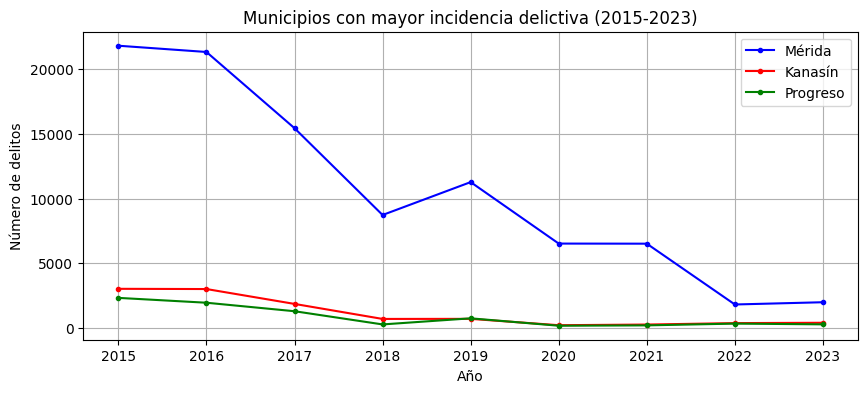

In [134]:
years = list(range(2015,2024))
plt.figure(figsize=(10,4))  
plt.plot(years, Delitos_Merida, 'b.-',label='Mérida')
plt.plot(years, Delitos_Kanasin, 'r.-',label='Kanasín')
plt.plot(years, Delitos_Progreso, 'g.-', label='Progreso')
plt.title('Municipios con mayor incidencia delictiva (2015-2023)')  
plt.xlabel('Año')
plt.ylabel('Número de delitos')
plt.legend(loc='best')
plt.grid(True)
plt.savefig('analisis_exp/municipios.png', dpi = 200, bbox_inches = 'tight')
plt.show()

## Mapas de incidencia delictiva por año

In [135]:
with open('datos/geo_yuc.json', 'r', encoding='utf-8') as file:
    geo_data = json.load(file)
municipios = []

for municipio in geo_data['features']:
    data = {
        'Nombre': municipio['properties']['NOMGEO'],
        'CVE_MUN': municipio['properties']['CVE_MUN']
        }
    municipios.append(data)
df_municipios = pd.DataFrame(municipios)

In [136]:
df_municipios = df_municipios.sort_values(by='CVE_MUN').reset_index(drop=True)
df_municipios.rename(columns={'Nombre': 'Municipio'}, inplace=1)

In [137]:
delitos2016 = df_yuc[df_yuc['Año'] == 2016].groupby('Municipio')['DelitosTotales'].sum()
delitos2016 = delitos2016.reset_index()
delitos2016 = pd.merge(df_municipios, delitos2016, on = 'Municipio')
delitos2016

,Municipio,CVE_MUN,DelitosTotales
0,Abalá,001,33.0
1,Acanceh,002,74.0
2,Akil,003,75.0
3,Baca,004,61.0
4,Bokobá,005,21.0
...,...,...,...
101,Valladolid,102,394.0
102,Xocchel,103,10.0
103,Yaxcabá,104,10.0
104,Yaxkukul,105,21.0


In [138]:
valores = delitos2016['DelitosTotales']
quantiles = np.quantile(valores, [0, 0.25, 0.5, 0.75, 1])
quantiles

array([0.0000e+00, 9.0000e+00, 2.0500e+01, 5.3250e+01, 2.1345e+04])

In [139]:
threshold_scale = [0, 10, 50, 500, 21345]

In [140]:
mapa_yuc = folium.Map(location=[20.7, -88.8], zoom_start=8)
geo_municipios = 'datos/geo_yuc.json'
folium.Choropleth(
    geo_data=geo_municipios,
    data=delitos2016,
    columns=['CVE_MUN', 'DelitosTotales'],
    key_on="feature.properties.CVE_MUN",
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    threshold_scale=threshold_scale,
    legend_name='Porcentaje de población que no posee nacionalidad mexicana en Yucatan'
).add_to(mapa_yuc)

style = """
<style>
    .legend {
        display: none !important;
    }
</style>
"""

mapa_yuc.get_root().html.add_child(folium.Element(style))

legend_html = """
<div style="position: fixed; 
            top: 10px; right: 10px; width: 150px; height: auto; 
            background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
            padding: 10px;">
    <div style="margin-bottom: 10px; text-align: center;"><strong>Número de delitos</strong></div>
    <div style="margin: 10px;">
        <i style="background: #FFFFB2; width: 18px; height: 18px; float: left; margin-right: 8px; opacity: 0.7;"></i>0-10<br>
        <i style="background: #FED976; width: 18px; height: 18px; float: left; margin-right: 8px; opacity: 0.7;"></i>11-50<br>
        <i style="background: #FC4E2A; width: 18px; height: 18px; float: left; margin-right: 8px; opacity: 0.7;"></i>51-500<br>
        <i style="background: #E31A1C; width: 18px; height: 18px; float: left; margin-right: 8px; opacity: 0.7;"></i>500+<br>
    </div>
</div>
"""

mapa_yuc.get_root().html.add_child(folium.Element(legend_html))

img_data = mapa_yuc._to_png(5) 
img = Image.open(io.BytesIO(img_data))
img.save('mapa_yuc_2016.png')

mapa_yuc

In [141]:
def MakeMap(year):
    delitos = df_yuc[df_yuc['Año'] == year].groupby('Municipio')['DelitosTotales'].sum()
    delitos = delitos.reset_index()
    delitos = pd.merge(df_municipios, delitos, on = 'Municipio')

    threshold_scale = [delitos['DelitosTotales'].min(), 10, 50, 500, delitos['DelitosTotales'].max()]
    
    mapa = folium.Map(location=[20.7, -88.8], zoom_start=8)
    geo_municipios = 'datos/geo_yuc.json'
    folium.Choropleth(
        geo_data=geo_municipios,
        data=delitos,
        columns=['CVE_MUN', 'DelitosTotales'],
        key_on="feature.properties.CVE_MUN",
        fill_color='YlOrRd',
        fill_opacity=0.7,
        line_opacity=0.2,
        threshold_scale=threshold_scale
        ).add_to(mapa)

    style = """
    <style>
        .legend {
            display: none !important;
        }
    </style>
    """
    
    mapa.get_root().html.add_child(folium.Element(style))

    legend_html = """
    <div style="position: fixed; 
                top: 10px; right: 10px; width: 150px; height: auto; 
                background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
                padding: 10px;">
        <div style="margin-bottom: 10px; text-align: center;"><strong>Número de delitos</strong></div>
        <div style="margin: 10px;">
            <i style="background: #FFFFB2; width: 18px; height: 18px; float: left; margin-right: 8px; opacity: 0.7;"></i>0-10<br>
            <i style="background: #FED976; width: 18px; height: 18px; float: left; margin-right: 8px; opacity: 0.7;"></i>11-50<br>
            <i style="background: #FC4E2A; width: 18px; height: 18px; float: left; margin-right: 8px; opacity: 0.7;"></i>51-500<br>
            <i style="background: #E31A1C; width: 18px; height: 18px; float: left; margin-right: 8px; opacity: 0.7;"></i>500+<br>
        </div>
    </div>
    """
    
    mapa.get_root().html.add_child(folium.Element(legend_html))

    img_data = mapa._to_png(5) 
    img = Image.open(io.BytesIO(img_data))
    img.save('mapa_yuc_'+str(year)+'.png')
    
    return mapa

In [142]:
mapa2017 = MakeMap(2017)

In [143]:
mapa2017

In [144]:
mapa2018 = MakeMap(2018)
mapa2018

In [145]:
mapa2019 = MakeMap(2019)
mapa2019

In [146]:
mapa2020 = MakeMap(2020)
mapa2020

In [147]:
mapa2021 = MakeMap(2021)
mapa2021

In [148]:
mapa2022 = MakeMap(2022)
mapa2022

In [149]:
mapa2023 = MakeMap(2023)
#mapa2023